In [1]:
import plotly.express as px
import pandas as pd
import pickle
import numpy as np
from os import listdir
import matplotlib.pyplot as plt

In [2]:
us_array_paths = [f for f in listdir("/github/data-mining-2022/Hitos/H3") if ("us" in f) and ("pickle" in f) and ("dm" in f or "report" in f or "projection" in f)]

In [3]:
path =  "../../Data/train/df_us_train.pickle"
df_us_train = pickle.load(open(path, "rb"))

In [4]:
sample_index_us = np.random.RandomState(0).choice(range(df_us_train.shape[0]), 20000)
labels = df_us_train.iloc[sample_index_us]["label"].values

In [5]:
us_results = []
for f in us_array_paths:
    if "report" in f:
        se, cm = f.replace("_us_report.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        for k, v in dict_m["metricas"].items():
            o = {"Vector": se, "Clustering": cm, "Metrica": k, "Valor": v}
            us_results.append(o)

In [6]:
df_us_results = pd.DataFrame(us_results)
df_us_results

,Vector,Clustering,Metrica,Valor
0,bertweet,dbscan,Silhouette,-0.196180
1,bertweet,dbscan,Rand score,0.219949
2,bertweet,dbscan,Mutual information,0.003311
3,bertweet,dbscan,Homogeneity,0.001925
4,bertweet,dbscan,Completeness,0.011831
...,...,...,...,...
91,w2v,kmeans,Rand score,0.865099
92,w2v,kmeans,Mutual information,0.062371
93,w2v,kmeans,Homogeneity,0.064443
94,w2v,kmeans,Completeness,0.060427


In [7]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "Silhouette"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="Silhouette: US",
    barmode='group')
fig.show(renderer="notebook")

In [8]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "Rand score"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="Rand score: US",
    barmode='group')
fig.show(renderer="notebook")

In [9]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "Mutual information"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="Mutual information: US",
    barmode='group')
fig.show(renderer="notebook")

In [10]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "Homogeneity"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="Homogeneity: US",
    barmode='group')
fig.show(renderer="notebook")

In [11]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "Completeness"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="Completeness: US",
    barmode='group')
fig.show(renderer="notebook")

In [12]:
fig = px.bar(df_us_results[df_us_results["Metrica"] == "V-measure"], x="Clustering", y="Valor", color="Vector",
                 width=600, height=400)
fig.update_layout(
    title="V-measure: US",
    barmode='group')
fig.show(renderer="notebook")

In [13]:
us_dm = []
for f in us_array_paths:
    if "dm" in f:
        se, cm = f.replace("_us_dm.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        o = [(se, cm), dict_m]
        us_dm.append(o)

In [14]:
def plot_distance_matrix(dict_dm, q1=0.05, q3=0.69, x0=-70, scale=1.02, num_tags=5):
    fig, ax = plt.subplots(1,1, figsize=(5, 5))
    vmin = np.quantile(dict_dm["matriz_distancias"].flatten(), q1)
    vmax = np.quantile(dict_dm["matriz_distancias"].flatten(), q3)
    ax.imshow(dict_dm["matriz_distancias"], cmap="jet", vmin=vmin, vmax=vmax);
    ax.set_title("Matriz de distancias")
    ax.set_yticks([])
    y_text = [sum(dict_dm["others"]["size_tags"][:i])+dict_dm["others"]["size_tags"][i]/2 for i in range(len(dict_dm["others"]["size_tags"]))]
    for cluster in range(num_tags):
        ax.text((y_text[cluster]+x0)*scale, y_text[cluster]*scale, str(dict_dm["others"]["tags_ord"][cluster]), size=15, color="white")
    ax.set_xticks([])
    plt.show()

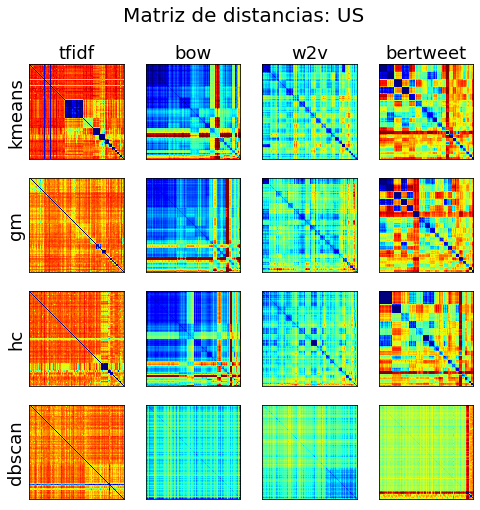

In [15]:
fig, ax = plt.subplots(4, 4, figsize=(8, 8))
q1=0.05
q3=0.95
x0=-70
scale=1.02
num_tags=5
for k, v in enumerate(us_dm):
    v0, v1 = v
    j, i = ["tfidf", "bow", "w2v", "bertweet"].index(v0[0]), ["kmeans", "gm", "hc", "dbscan"].index(v0[1])
    vmin = np.quantile(v1["matriz_distancias"].flatten(), q1)
    vmax = np.quantile(v1["matriz_distancias"].flatten(), q3)
    ax[i,j].imshow(v1["matriz_distancias"], cmap="jet", vmin=vmin, vmax=vmax)
    ax[i,j].set_yticks([])
    ax[i,j].set_xticks([])
    if i==0:
        ax[i,j].set_title(v0[0], size=18)
    if j==0:
        ax[i,j].set_ylabel(v0[1], size=18)
plt.suptitle("Matriz de distancias: US", size=20);
fig.savefig('MD_US.jpg', bbox_inches='tight')

In [16]:
us_prjt = {"pca": {}, "tsne": {}, "umap": {}}
for f in us_array_paths:
    if "projection" in f:
        se, rd = f.split("_")[:2]
        reduced = pickle.load(open(f, "rb"))["reduced"]
        us_prjt[rd][se] = reduced

In [17]:
us_clusters = {"kmeans": {}, "hc": {}, "gm": {}, "dbscan": {}}
for f in us_array_paths:
    if "report" in f:
        se, cm = f.replace("_us_report.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        us_clusters[cm][se] = dict_m["clusters"]

In [18]:
plot_sample_index_us = np.random.RandomState(0).choice(range(20000), 1000)

In [19]:
def plot_prj(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(4, 4, figsize=(10, 10))
    for i, cm in enumerate(["kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "bertweet"]):
            clusters = us_clusters[cm][se][plot_sample_index_us]
            x = us_prjt[prj][se][plot_sample_index_us,0]
            y = us_prjt[prj][se][plot_sample_index_us,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: US", size=20);
    fig.savefig(f'{prj.upper()}_US.jpg', bbox_inches='tight')

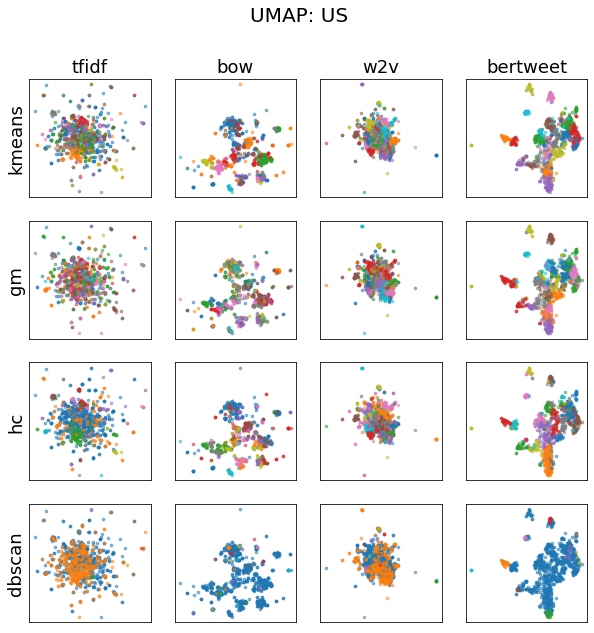

In [20]:
plot_prj("umap")

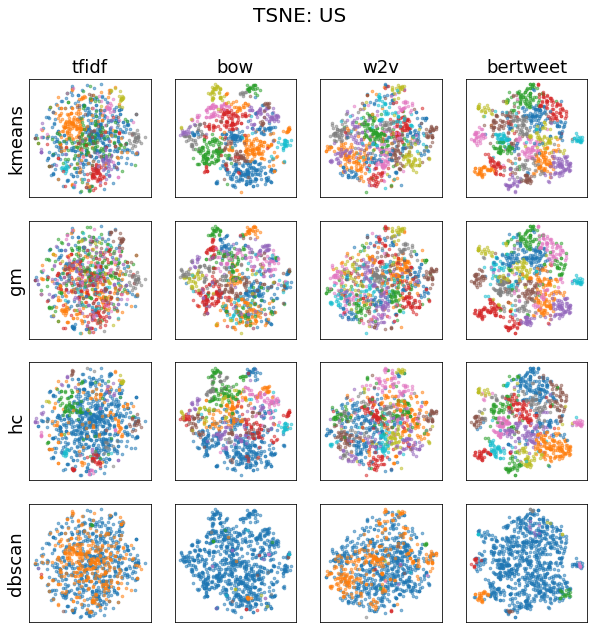

In [21]:
plot_prj("tsne")

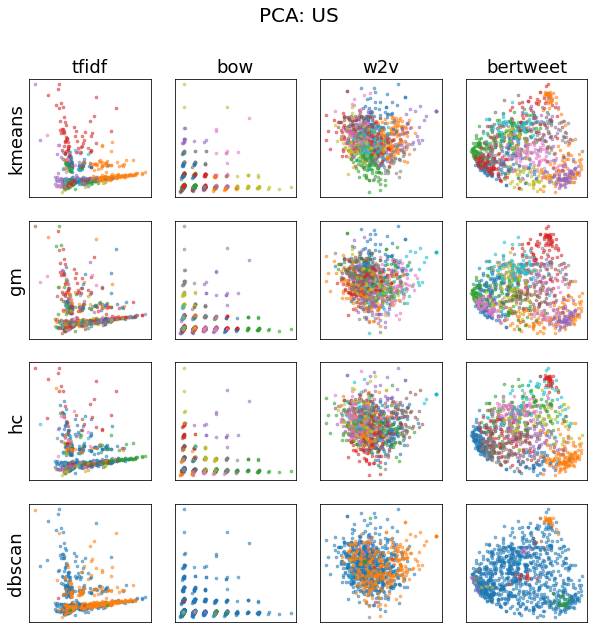

In [22]:
plot_prj("pca")

In [23]:
def plot_prj_and_labels(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(5, 4, figsize=(10, 10))
    for i, cm in enumerate(["emoji", "kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "bertweet"]):
            clusters = us_clusters[cm][se][plot_sample_index_us] if i>0 else labels[plot_sample_index_us]
            x = us_prjt[prj][se][plot_sample_index_us,0]
            y = us_prjt[prj][se][plot_sample_index_us,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: US", size=20);
#     fig.savefig(f'{prj.upper()}_US.jpg', bbox_inches='tight')

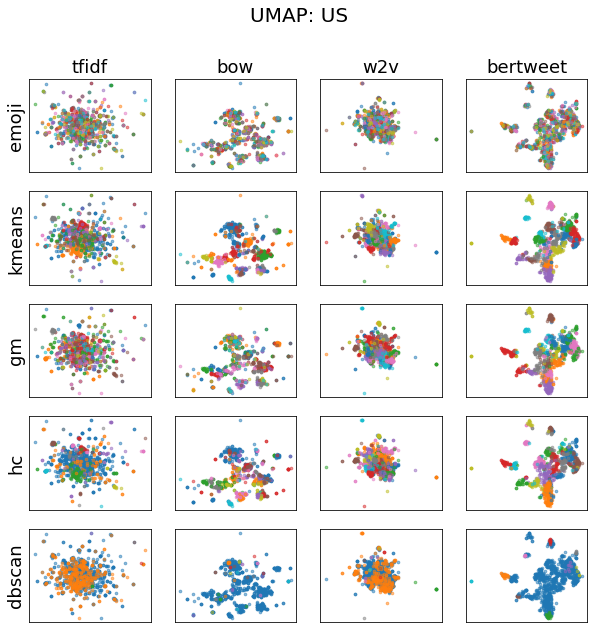

In [24]:
plot_prj_and_labels("umap")

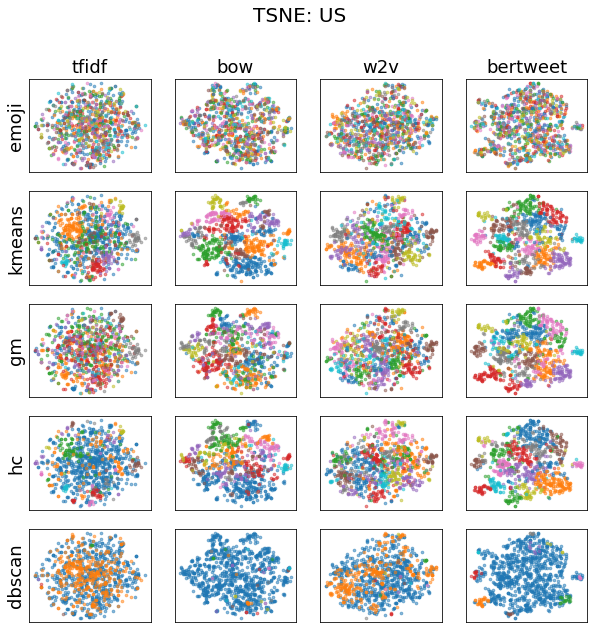

In [25]:
plot_prj_and_labels("tsne")

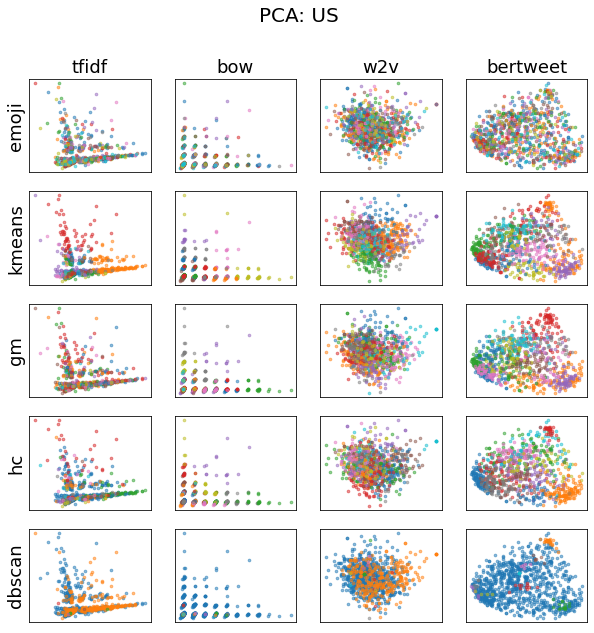

In [26]:
plot_prj_and_labels("pca")